In [1]:
%load_ext autoreload
%autoreload 2
import numpy as np
import matplotlib.pylab as plt
import matplotlib.colors as colors
import matplotlib.patches as patches
import torchvision
import matplotlib.patches as patches
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import matplotlib.gridspec as gridspec
from mpl_toolkits.mplot3d import Axes3D

import os
import time
import torch
import sys
import argparse
sys.path.insert(0, '../../shared_code')
from model_loader_func import * 
from dataloader_func import *
from quality_metrics_func import *
from linear_approx import *
from inverse_tasks_func import synthesis
from plotting_func import *
from algorithm_inv_prob import * 
from trainer import make_loader
%matplotlib inline

In [2]:
print(torch.__version__)
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
device

2.5.0+cu124


device(type='cuda')

In [3]:
compute_UNet_RF(num_enc_conv=[2,2,2,2],  num_mid_conv=3, kernel_size=3)

172

In [4]:
similarity_matrix = lambda data : data/data.norm(dim = 1, keepdim=True) @(data/data.norm(dim = 1, keepdim=True)).T
similarity_vactor = lambda data, v : (v/(v.norm(dim = 1, keepdim=True)+1e-6) @(data/(data.norm(dim = 1, keepdim=True) +1e-6 ) ).T).flatten()
similarity_matrix_2mats = lambda data1, data2 : data1/data1.norm(dim = 1, keepdim=True) @(data2/data2.norm(dim = 1, keepdim=True)).T

degree_matrix = lambda sim_mat : torch.diag(sim_mat.sum(dim = 1))

participation_ratio = lambda v :  (v.norm(1)**2)/v.norm(2)**2/len(v)
participation_ratio_dataset = lambda data :  (data.norm(1, dim = 1)**2)/data.norm(2,dim = 1)**2/data.shape[1]


In [72]:
denoisers = {}

root_path = '/mnt/home/zkadkhodaie/ceph/22_representation_in_UNet_denoiser/denoisers/'

paths= {  
            'mixture-color-deep-no-skip-faces-200k-0to255': 'UNet_flex/img_align_celeba/0to255_RF_84x84_set_size_202399_color_no_skip_deep_dec_80x80/',
             'mixture-color-deep-no-skip-faces-150k': 'UNet_flex/img_align_celeba/1to765_RF_84x84_set_size_150000_color_no_skip_deep_dec_80x80/',
            'mixture-color-deep-no-skip-bedroom-300k-0to255': 'UNet_flex/bedroom/0to255_RF_84x84_set_size_299718_color_no_skip_deep_dec_80x80/',
            'mixture-color-deep-no-skip-bedroom-150k':'UNet_flex/bedroom/1to765_RF_84x84_set_size_150000_color_no_skip_deep_dec_80x80/',
            'mixture-color-deep-no-skip-twoClass-200k-0to255': 'UNet_flex/face_bedroom/0to255_RF_84x84_set_size_200000_color_no_skip_deep_dec_80x80/',   
            'mixture-color-deep-no-skip-twoClass-150k': 'UNet_flex/face_bedroom/1to765_RF_84x84_set_size_150000_color_no_skip_deep_dec_80x80/',
            'mixture-color-deep-no-skip-twoClass-150k-swapped': 'UNet_flex/face_bedroom/1to765_RF_84x84_set_size_150000_swapped_color_no_skip_deep_dec_80x80/',    
            'mixture-color-deep-no-skip-twoClass-300k': 'UNet_flex/face_bedroom/1to765_RF_84x84_set_size_300000_color_no_skip_deep_dec_80x80/',
            'mixture-color-deep-no-skip-twoClass-400k': 'UNet_flex/face_bedroom/1to765_RF_84x84_set_size_400000_color_no_skip_deep_dec_80x80/',    
            
        }

groups = paths.keys()


for group in groups: 
    path = root_path + paths[group]
    
    print('loading group ' , group )
    if 'modified' in group.split('-'):
        new_arch = 'UNet_conditional_mean_matching'
    else: 
        new_arch = None
    denoisers[group] = load_learned_model(path, print_args=True, new_arch=new_arch)
    start_time_total = time.time()        
    print("--- %s seconds ---" % (round(time.time() - start_time_total)))
     

loading group  mixture-color-deep-no-skip-faces-200k-0to255
*************** saved arguments:*************
arch_name UNet_flex
lr 0.001
batch_size 2048
num_epochs 1500
lr_freq 100
loss_weight False
noise_level_range [0, 255]
quadratic_noise True
rescale False
swap False
set_size 202399
imagenet_subset_ids None
data_name img_align_celeba
data_root_path /mnt/home/zkadkhodaie/ceph/datasets/
dir_name /mnt/home/zkadkhodaie/ceph/22_representation_in_UNet_denoiser/denoisers/UNet_flex/img_align_celeba/0to255_RF_84x84_set_size_202399_color_no_skip_deep_dec_l1_penalty_80x80
optional_dir_label color_no_skip_deep_dec_l1_penalty
device cuda
debug False
kernel_size 3
padding 1
skip False
num_channels 3
bias True
RF 84
coarse True
self_cond False
num_kernels [64, 128, 256, 512]
num_blocks 3
num_enc_conv [2, 2, 2]
num_mid_conv 3
num_dec_conv [6, 6, 6]
NormType LayerNorm
inter_skip True
dilations None
upsample_with_bias False
sparsify_phi False
lambda_l1 None
********************************************

In [6]:
train_sets = {}
test_sets = {}
categories = ['img_align_celeba', 'bedroom']

for category in categories:
    start_t = time.time()
    print(category)
    data = torch.load( '/mnt/home/zkadkhodaie/ceph/datasets/' + category +'/train_color_80x80.pt', weights_only=True)    
    print(category, data.shape)
    # if category == 'img_align_celeba' or category == 'bedroom': 
    #     N = 150_000

    N = 1024
    train = data[0:N]    
    test = data[-1024::]
    
    
    train_sets[category] = train
    test_sets[category] = test
    print('time to upload: ' ,time.time() - start_t )

img_align_celeba
img_align_celeba torch.Size([202499, 3, 80, 80])
time to upload:  139.04715609550476
bedroom
bedroom torch.Size([299818, 3, 80, 80])
time to upload:  179.2515389919281


In [16]:
train_sets_cat = torch.cat([train_sets[c] for c in categories ])
print(train_sets_cat.shape)

test_sets_cat = torch.cat([test_sets[c] for c in categories ])
test_sets_cat.shape

torch.Size([2048, 3, 80, 80])


torch.Size([2048, 3, 80, 80])

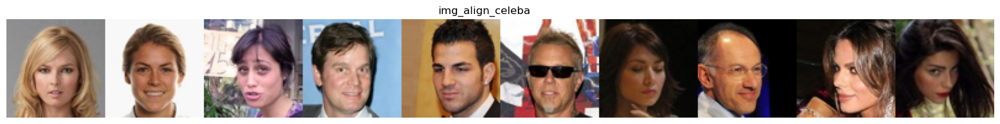

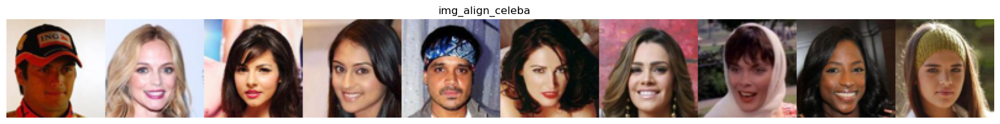

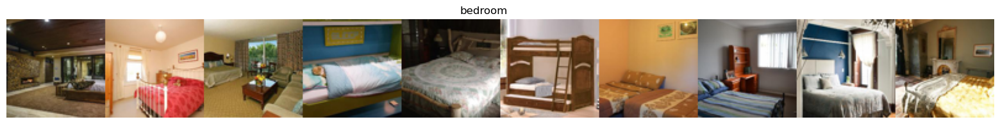

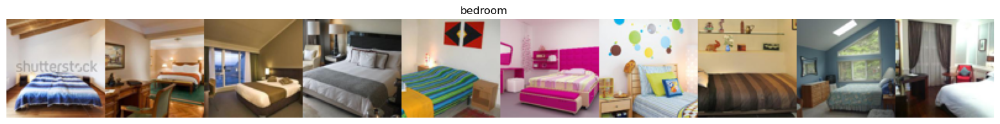

In [8]:
for category in categories: 
    show_im_grid(train_sets[category][0:10], n_columns=10, label=category, font_size=8, im_size = 2)   
    show_im_grid(test_sets[category][0:10], n_columns=10, label=category, font_size=8, im_size = 2)   

In [9]:
## plotting stuff: 
noise_colormap = plt.cm.copper 
scale_colormap = plt.cm.seismic
model_colormap = plt.cm.Dark2
dataset_colormap = plt.cm.Set3

dataset_colors = {}
temp = [dataset_colormap(i) for i in np.linspace(0, 1, len(test_sets.keys()) )]
i = 0
for dataset in test_sets.keys():
    dataset_colors[dataset] = temp[i]
    i+=1
    
model_colors = {}
temp = [model_colormap(i) for i in np.linspace(0, 1, len(groups )+1 )]
i = 0
for group in groups:
    model_colors[group] = temp[i]
    i+=1

# Denoising performance 

In [41]:
groups

dict_keys(['mixture-color-deep-no-skip-faces-200k-0to255', 'mixture-color-deep-no-skip-faces-150k', 'mixture-color-deep-no-skip-bedroom-300k-0to255', 'mixture-color-deep-no-skip-bedroom-150k', 'mixture-color-deep-no-skip-twoClass-200k-0to255', 'mixture-color-deep-no-skip-twoClass-150k', 'mixture-color-deep-no-skip-twoClass-150k-swapped', 'mixture-color-deep-no-skip-twoClass-300k', 'mixture-color-deep-no-skip-twoClass-400k'])

In [42]:
## compute psnr 
sig_range = torch.logspace(np.log10(1),np.log10(255 * 3),25)

# psnr_test = {}
# psnr_train = {}

for group in ['mixture-color-deep-no-skip-faces-200k-0to255', 'mixture-color-deep-no-skip-bedroom-300k-0to255']:

    print('---------- model: ', group)
    psnr_test[group] = {}
    psnr_train[group] = {}    
    for dataset in train_sets.keys():
        ## test
        print(dataset)
        loader = DataLoader(dataset=test_sets[dataset], batch_size=512, shuffle=False)        
        if 'skip' in group.split('-'): 
            skip = False
        else: 
            skip = True        
        psnr_test[group][dataset] = calc_psnr(denoisers[group],loader,sig_range, device, skip=skip)
    
        ## train
        loader = DataLoader(dataset=train_sets[dataset], batch_size=512, shuffle=False)        
        if 'skip' in group.split('-'): 
            skip = False
        else: 
            skip = True        
        psnr_train[group][dataset] = calc_psnr(denoisers[group],loader,sig_range, device, skip=skip)

---------- model:  mixture-color-deep-no-skip-faces-200k-0to255
img_align_celeba
bedroom
---------- model:  mixture-color-deep-no-skip-bedroom-300k-0to255
img_align_celeba
bedroom


In [66]:
groups

dict_keys(['mixture-color-deep-no-skip-faces-200k-0to255', 'mixture-color-deep-no-skip-faces', 'mixture-color-deep-no-skip-bedroom-300k-0to255', 'mixture-color-deep-no-skip-bedroom', 'mixture-color-deep-no-skip-twoClass-200k-0to255', 'mixture-color-deep-no-skip-twoClass-150k', 'mixture-color-deep-no-skip-twoClass-150k-swapped', 'mixture-color-deep-no-skip-twoClass-300k', 'mixture-color-deep-no-skip-twoClass-400k'])

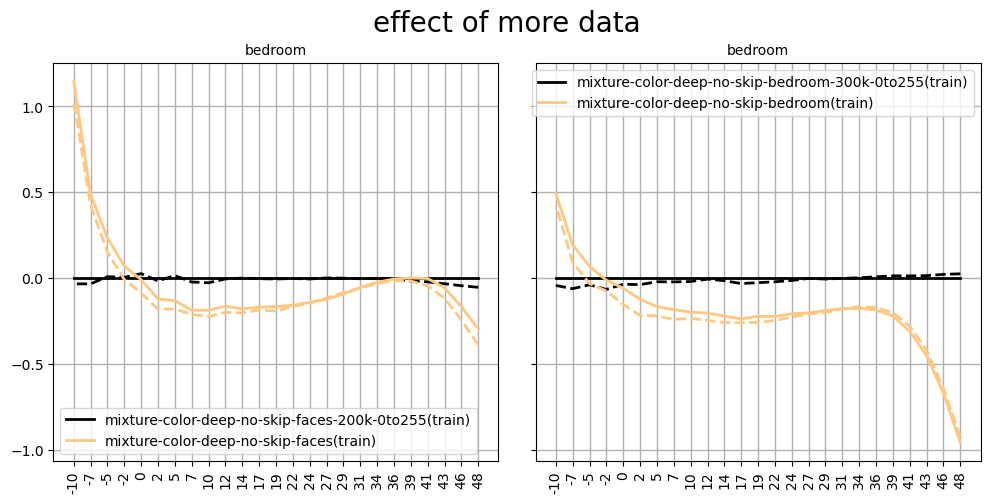

In [71]:
## plot 
f , axs = plt.subplots(1,2, figsize=(5 * 2,5), sharex = True, sharey=True)
f.suptitle('effect of more data', fontsize = 20)
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, 2 )]

plt.tight_layout()
axs = axs.ravel()
baseline_group = 'mixture-color-deep-no-skip-faces-200k-0to255'
x_axis = [ -10*np.log10( (float(std)/255)**2  ) for std in psnr_test[baseline_group][dataset].keys()]
j = 0
dataset = 'img_align_celeba'
for group in [ 'mixture-color-deep-no-skip-faces-200k-0to255', 'mixture-color-deep-no-skip-faces-150k' ]:
        axs[0].plot(x_axis, torch.tensor([psnr_train[group][dataset][key] for key in psnr_train[group][dataset].keys()]) - torch.tensor([psnr_train[baseline_group][dataset][key] for key in psnr_train[baseline_group][dataset].keys()]), 
                    label =  group + '(train)' , alpha = 1, color=plot_colors[j], lw = 2)
        axs[0].plot(x_axis, torch.tensor([psnr_test[group][dataset][key] for key in psnr_test[group][dataset].keys()]) - torch.tensor([psnr_train[baseline_group][dataset][key] for key in psnr_train[baseline_group][dataset].keys()]), '--',
                      alpha = 1, color=plot_colors[j], lw = 2)        
        j+= 1  

baseline_group = 'mixture-color-deep-no-skip-bedroom-300k-0to255'
j = 0
dataset = 'bedroom'
for group in [ 'mixture-color-deep-no-skip-bedroom-300k-0to255', 'mixture-color-deep-no-skip-bedroom-150k' ]:
        axs[1].plot(x_axis, torch.tensor([psnr_train[group][dataset][key] for key in psnr_train[group][dataset].keys()]) - torch.tensor([psnr_train[baseline_group][dataset][key] for key in psnr_train[baseline_group][dataset].keys()]), 
                    label =  group + '(train)' , alpha = 1, color=plot_colors[j], lw = 2)
        axs[1].plot(x_axis, torch.tensor([psnr_test[group][dataset][key] for key in psnr_test[group][dataset].keys()]) - torch.tensor([psnr_train[baseline_group][dataset][key] for key in psnr_train[baseline_group][dataset].keys()]), '--',
                      alpha = 1, color=plot_colors[j], lw = 2)        
        j+= 1  

for i in range(2):
    axs[i].set_xticks(x_axis);
    
    axs[i].grid(  linewidth=1);
    axs[i].set_xticklabels(np.round(x_axis).astype(int) ,rotation=90, fontsize=10)
    axs[i].set_title(dataset, fontsize = 10)
    i += 1
    
    axs[0].legend(  fontsize = 10);
    axs[1].legend(  fontsize = 10);


mixture-color-deep-no-skip-twoClass-150k-swapped
mixture-color-deep-no-skip-twoClass-150k-swapped


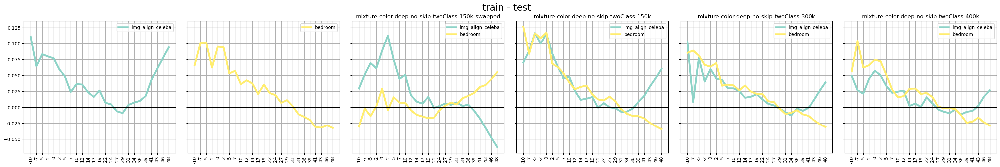

In [14]:
## plot 
f , axs = plt.subplots(1, 6, figsize=(5 * 6,5), sharex = True, sharey=True)
f.suptitle('train - test', fontsize = 20)
plot_colors = [dataset_colormap(i) for i in np.linspace(0, 1, 2 )]

plt.tight_layout()
# axs = axs.ravel()
i = 0
group = 'mixture-color-deep-no-skip-faces-150k'
dataset = 'img_align_celeba'
x_axis = [ -10*np.log10( (float(std)/255)**2  ) for std in psnr_test[group][dataset].keys()]

axs[i].plot(x_axis, torch.tensor([psnr_train[group][dataset][key] for key in psnr_train[group][dataset].keys()]) - torch.tensor([psnr_test[group][dataset][key] for key in psnr_test[group][dataset].keys()]), 
            label =  dataset , alpha = 1, color=plot_colors[0] , lw = 4)
i = 1
group = 'mixture-color-deep-no-skip-bedroom-150k'
dataset = 'bedroom'
axs[i].plot(x_axis, torch.tensor([psnr_train[group][dataset][key] for key in psnr_train[group][dataset].keys()]) - torch.tensor([psnr_test[group][dataset][key] for key in psnr_test[group][dataset].keys()]), 
            label =  dataset , alpha = 1, color=plot_colors[1] , lw = 4)

i = 2
for group in ['mixture-color-deep-no-skip-twoClass-150k-swapped', 'mixture-color-deep-no-skip-twoClass-150k', 'mixture-color-deep-no-skip-twoClass-300k', 'mixture-color-deep-no-skip-twoClass-400k' ]: 
    x_axis = [ -10*np.log10( (float(std)/255)**2  ) for std in psnr_test[group][dataset].keys()]        
    j = 0
    for dataset in test_sets.keys():
            
        if 'swapped' not in group.split('-'): 
            axs[i].plot(x_axis, torch.tensor([psnr_train[group][dataset][key] for key in psnr_train[group][dataset].keys()]) - torch.tensor([psnr_test[group][dataset][key] for key in psnr_test[group][dataset].keys()]), 
                    label =  dataset , alpha = 1, color=plot_colors[j] , lw = 4)
        else: 
            print(group)
            axs[i].plot(x_axis, torch.tensor([psnr_test[group][dataset][key] for key in psnr_test[group][dataset].keys()]) - torch.tensor([psnr_train[group][dataset][key] for key in psnr_train[group][dataset].keys()]), 
                    label =  dataset , alpha = 1, color=plot_colors[j] , lw = 4)
            
        j += 1
    axs[i].set_title(group, fontsize = 12)

    i += 1

for i in range(6):
    axs[i].set_xticks(x_axis);
    axs[i].grid(  linewidth=1);
    axs[i].set_xticklabels(np.round(x_axis).astype(int) ,rotation=90, fontsize=10)
    axs[i].legend(  fontsize = 10);
    axs[i].axhline(0, color = 'k')


### Observations: 

- It seems like all the models have not fully generalized for large noise levels (although I don't know how significant it is. Numbers of very small. So it might change with a diffrent bacth of data)
- large data model is a hair more generalized than the small data model (Is it significant?)


In [43]:
## compute psnr 

sig_range = torch.logspace(np.log10(1),np.log10(255 * 3),25)

# psnrs_train_cat = {}
# psnrs_test_cat  ={}

for group in ['mixture-color-deep-no-skip-faces-200k-0to255', 'mixture-color-deep-no-skip-bedroom-300k-0to255']:

    print('---------- model: ', group)
 
    ## test
    loader = DataLoader(dataset=test_sets_cat, batch_size=512, shuffle=False)        
    if 'skip' in group.split('-'): 
        skip = False
    else: 
        skip = True        
    psnrs_test_cat[group] = calc_psnr(denoisers[group],loader,sig_range, device, skip=skip)

    ## train
    loader = DataLoader(dataset=train_sets_cat, batch_size=512, shuffle=False)        
    if 'skip' in group.split('-'): 
        skip = False
    else: 
        skip = True        
    psnrs_train_cat[group] = calc_psnr(denoisers[group],loader,sig_range, device, skip=skip)


---------- model:  mixture-color-deep-no-skip-faces-200k-0to255
---------- model:  mixture-color-deep-no-skip-bedroom-300k-0to255


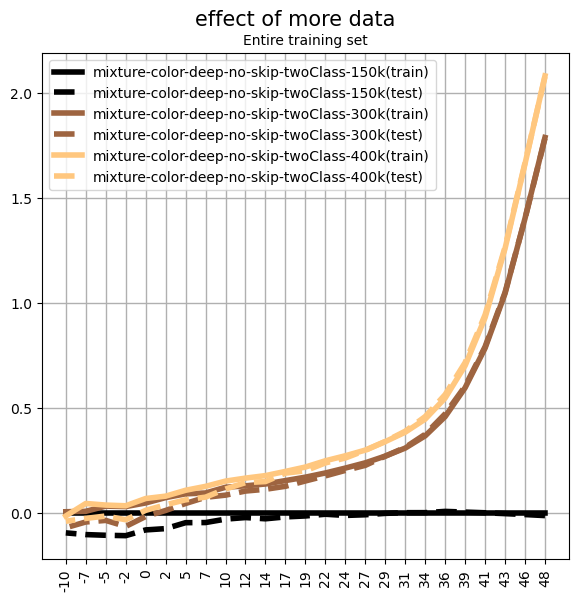

In [19]:
## plot 
f , axs = plt.subplots(1,1, figsize=(6 ,6), sharex = True, sharey=True)
f.suptitle('effect of more data', fontsize = 15)
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, 3 )]

plt.tight_layout()
i = 0
baseline_group = 'mixture-color-deep-no-skip-twoClass-150k'
x_axis = [ -10*np.log10( (float(std)/255)**2  ) for std in psnr_test[baseline_group][dataset].keys()]

j = 0
for group in [ 'mixture-color-deep-no-skip-twoClass-150k', 'mixture-color-deep-no-skip-twoClass-300k', 'mixture-color-deep-no-skip-twoClass-400k']:
        axs.plot(x_axis, torch.tensor([psnrs_train_cat[group][key] for key in psnrs_train_cat[group].keys()]) - torch.tensor([psnrs_train_cat[baseline_group][key] for key in psnrs_train_cat[baseline_group].keys()]), 
                    label =  group + '(train)' , alpha = 1, color=plot_colors[j], lw = 4)
        axs.plot(x_axis, torch.tensor([psnrs_test_cat[group][key] for key in psnrs_test_cat[group].keys()]) - torch.tensor([psnrs_train_cat[baseline_group][key] for key in psnrs_train_cat[baseline_group].keys()]), '--',
                      label =  group + '(test)'  ,alpha = 1, color=plot_colors[j], lw = 4)        
        j += 1
axs.set_xticks(x_axis);

axs.grid(  linewidth=1);
axs.set_xticklabels(np.round(x_axis).astype(int) ,rotation=90, fontsize=10)
axs.legend(  fontsize = 10);
axs.set_title('Entire training set', fontsize = 10);


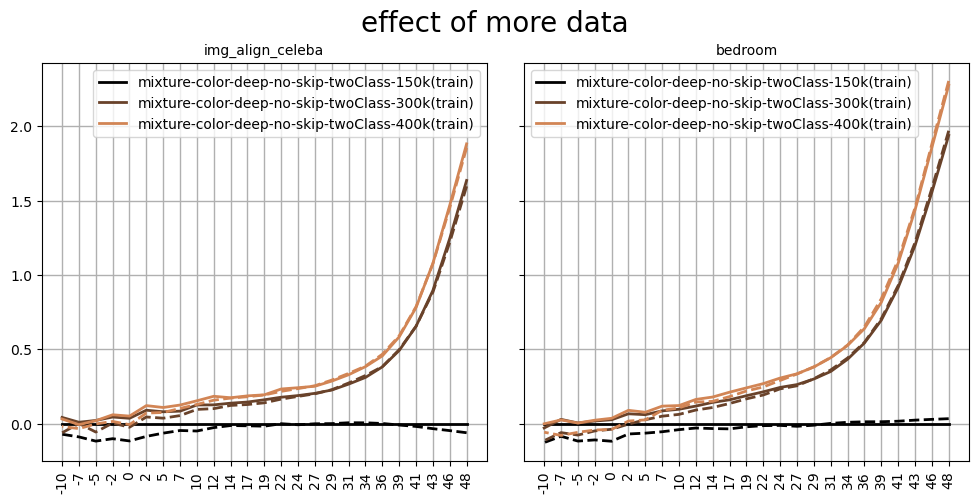

In [20]:
## plot 
f , axs = plt.subplots(1,2, figsize=(5 * 2,5), sharex = True, sharey=True)
f.suptitle('effect of more data', fontsize = 20)
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, 4 )]

plt.tight_layout()
axs = axs.ravel()
i = 0
baseline_group = 'mixture-color-deep-no-skip-twoClass-150k'
x_axis = [ -10*np.log10( (float(std)/255)**2  ) for std in psnr_test[baseline_group][dataset].keys()]

for dataset in train_sets.keys():
    j = 0
    for group in [ 'mixture-color-deep-no-skip-twoClass-150k', 'mixture-color-deep-no-skip-twoClass-300k', 'mixture-color-deep-no-skip-twoClass-400k' ]:
            axs[i].plot(x_axis, torch.tensor([psnr_train[group][dataset][key] for key in psnr_train[group][dataset].keys()]) - torch.tensor([psnr_train[baseline_group][dataset][key] for key in psnr_train[baseline_group][dataset].keys()]), 
                        label =  group + '(train)' , alpha = 1, color=plot_colors[j], lw = 2)
            axs[i].plot(x_axis, torch.tensor([psnr_test[group][dataset][key] for key in psnr_test[group][dataset].keys()]) - torch.tensor([psnr_train[baseline_group][dataset][key] for key in psnr_train[baseline_group][dataset].keys()]), '--',
                          alpha = 1, color=plot_colors[j], lw = 2)        
            j += 1
            
        
    axs[i].set_xticks(x_axis);
    
    axs[i].grid(  linewidth=1);
    axs[i].set_xticklabels(np.round(x_axis).astype(int) ,rotation=90, fontsize=10)
    axs[i].set_title(dataset, fontsize = 10)
    i += 1

axs[0].legend(  fontsize = 10);
axs[1].legend(  fontsize = 10);


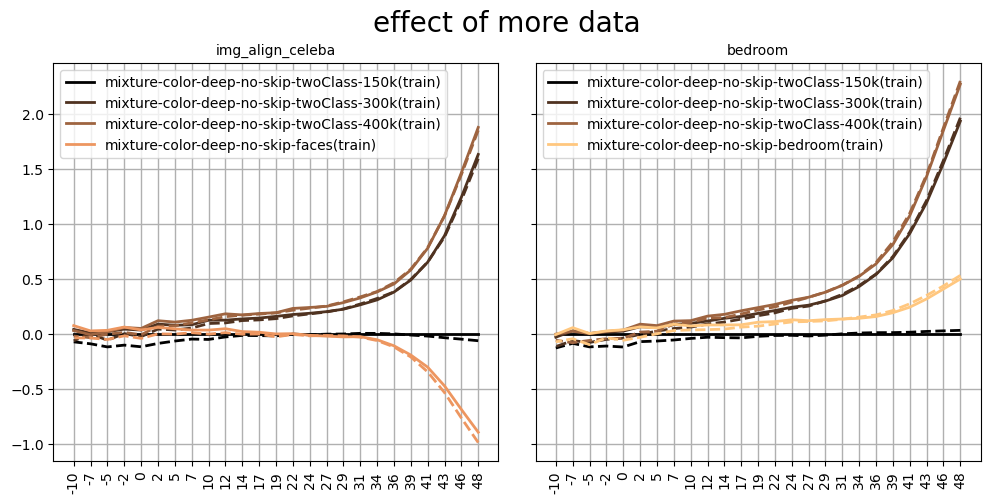

In [45]:
## plot 
f , axs = plt.subplots(1,2, figsize=(5 * 2,5), sharex = True, sharey=True)
f.suptitle('effect of more data', fontsize = 20)
plot_colors = [noise_colormap(i) for i in np.linspace(0, 1, 5 )]

plt.tight_layout()
axs = axs.ravel()
i = 0
baseline_group = 'mixture-color-deep-no-skip-twoClass-150k'
x_axis = [ -10*np.log10( (float(std)/255)**2  ) for std in psnr_test[baseline_group][dataset].keys()]

for dataset in train_sets.keys():
    j = 0
    for group in [ 'mixture-color-deep-no-skip-twoClass-150k', 'mixture-color-deep-no-skip-twoClass-300k' , 'mixture-color-deep-no-skip-twoClass-400k'  ]:
            axs[i].plot(x_axis, torch.tensor([psnr_train[group][dataset][key] for key in psnr_train[group][dataset].keys()]) - torch.tensor([psnr_train[baseline_group][dataset][key] for key in psnr_train[baseline_group][dataset].keys()]), 
                        label =  group + '(train)' , alpha = 1, color=plot_colors[j], lw = 2)
            axs[i].plot(x_axis, torch.tensor([psnr_test[group][dataset][key] for key in psnr_test[group][dataset].keys()]) - torch.tensor([psnr_train[baseline_group][dataset][key] for key in psnr_train[baseline_group][dataset].keys()]), '--',
                          alpha = 1, color=plot_colors[j], lw = 2)        
            j += 1
            
        
    axs[i].set_xticks(x_axis);
    
    axs[i].grid(  linewidth=1);
    axs[i].set_xticklabels(np.round(x_axis).astype(int) ,rotation=90, fontsize=10)
    axs[i].set_title(dataset, fontsize = 10)
    i += 1

group = 'mixture-color-deep-no-skip-faces'
dataset = 'img_align_celeba'
axs[0].plot(x_axis, torch.tensor([psnr_train[group][dataset][key] for key in psnr_train[group][dataset].keys()]) - torch.tensor([psnr_train[baseline_group][dataset][key] for key in psnr_train[baseline_group][dataset].keys()]), 
                        label =  group + '(train)' , alpha = 1, color=plot_colors[j], lw = 2)
axs[0].plot(x_axis, torch.tensor([psnr_test[group][dataset][key] for key in psnr_test[group][dataset].keys()]) - torch.tensor([psnr_train[baseline_group][dataset][key] for key in psnr_train[baseline_group][dataset].keys()]), '--',
                          alpha = 1, color=plot_colors[j], lw = 2)  
j +=1
group = 'mixture-color-deep-no-skip-bedroom'
dataset = 'bedroom'
axs[1].plot(x_axis, torch.tensor([psnr_train[group][dataset][key] for key in psnr_train[group][dataset].keys()]) - torch.tensor([psnr_train[baseline_group][dataset][key] for key in psnr_train[baseline_group][dataset].keys()]), 
                        label =  group + '(train)' , alpha = 1, color=plot_colors[j], lw = 2)
axs[1].plot(x_axis, torch.tensor([psnr_test[group][dataset][key] for key in psnr_test[group][dataset].keys()]) - torch.tensor([psnr_train[baseline_group][dataset][key] for key in psnr_train[baseline_group][dataset].keys()]), '--',
                           alpha = 1, color=plot_colors[j], lw = 2)  
axs[0].legend(  fontsize = 10);
axs[1].legend(  fontsize = 10);


In [357]:
groups

dict_keys(['mixture-color-deep-no-skip-faces', 'mixture-color-deep-no-skip-bedroom', 'mixture-color-deep-no-skip-twoClass-150k', 'mixture-color-deep-no-skip-twoClass-150k-swapped', 'mixture-color-deep-no-skip-twoClass-300k', 'mixture-color-deep-no-skip-twoClass-400k'])

# Synthesis - unconditional 

In [73]:
K = train_sets_cat.shape[2]
n_samples =20
seed = 100
freq =100
sig_L = .1
h0= .01
beta = .05
sig_0 = 3
fixed_h =True
# all_samples = {}
# all_interm_Ys = {}
start_time_total = time.time()


for group in ['mixture-color-deep-no-skip-faces-150k', 'mixture-color-deep-no-skip-bedroom-150k']:
    if 'skip' in group.split('-'): 
        skip = False
    else: 
        skip = True
        
    if seed is not None:
        torch.manual_seed(seed )
        

    
    print('--------- group : ', group)        
    all_samples[group] = {}
    all_interm_Ys[group] = {}            
    temp = []
    for i in range(1):    
        if 'color' in group.split('-'): 
            n_channels = 3
            init_im = torch.ones((n_samples,n_channels ,K,K) ,device = device )*.45+ torch.randn(n_samples,n_channels ,K,K, device = device)*sig_0
            
        else: 
            n_channels = 1        
            init_im = .45+ torch.randn(n_samples,n_channels ,K,K, device = device) * sig_0

        
        sample, interm_Ys,sigs, means, _ = batch_synthesis(denoisers[group],
                                              init_im=init_im, 
                                              sig_L=sig_L, 
                                              h0=h0, 
                                              beta=beta, 
                                              freq=freq,
                                              device=device, 
                                              fixed_h = fixed_h,
                                              max_T=20000, 
                                              seed= seed , 
                                              skip = skip
                                              )
                    
        temp.append(sample.detach())    
    
    all_samples[group] = torch.cat(temp)
    all_interm_Ys[group] = interm_Ys
    
            
print("--- %s seconds ---" % (time.time() - start_time_total))

--------- group :  mixture-color-deep-no-skip-faces-150k
----------------------------- 100
sigma  2.4334716796875
mean  0.4509495794773102
----------------------------- 200
sigma  2.2965943813323975
mean  0.4513104557991028
----------------------------- 300
sigma  2.1677775382995605
mean  0.44368115067481995
----------------------------- 400
sigma  2.0535361766815186
mean  0.4439731538295746
----------------------------- 500
sigma  1.9398399591445923
mean  0.4396078288555145
----------------------------- 600
sigma  1.8350937366485596
mean  0.43565332889556885
----------------------------- 700
sigma  1.7361561059951782
mean  0.4304960370063782
----------------------------- 800
sigma  1.6438419818878174
mean  0.4283196032047272
----------------------------- 900
sigma  1.5589494705200195
mean  0.4292587339878082
----------------------------- 1000
sigma  1.4713548421859741
mean  0.4287758767604828
----------------------------- 1100
sigma  1.3962494134902954
mean  0.428690105676651
--------

# Expectation: 

Strong convergence with N = 150k, but lower quality compared to ultimate consitional models

In [47]:
groups

dict_keys(['mixture-color-deep-no-skip-faces-200k-0to255', 'mixture-color-deep-no-skip-faces-150k', 'mixture-color-deep-no-skip-bedroom-300k-0to255', 'mixture-color-deep-no-skip-bedroom-150k', 'mixture-color-deep-no-skip-twoClass-200k-0to255', 'mixture-color-deep-no-skip-twoClass-150k', 'mixture-color-deep-no-skip-twoClass-150k-swapped', 'mixture-color-deep-no-skip-twoClass-300k', 'mixture-color-deep-no-skip-twoClass-400k'])

fixed_h= True  sig_L=  0.1  sig_0= 3  h0= 0.01  beta= 0.05  seed= 100


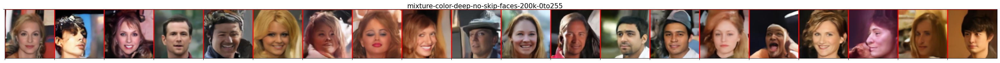

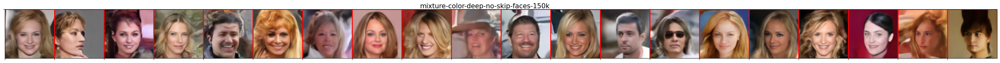

In [74]:

subgroups = ['mixture-color-deep-no-skip-faces-200k-0to255', 'mixture-color-deep-no-skip-faces-150k']
print( 'fixed_h=', fixed_h, ' sig_L= ',sig_L,  ' sig_0=', sig_0,' h0=', h0, ' beta=',beta, ' seed=', seed)
for group in subgroups:
    show_im_grid(torch.clip(all_samples[group], 0,1), n_columns=20, label=group, grid_lines=True, font_size = 10)

fixed_h= True  sig_L=  0.1  sig_0= 3  h0= 0.01  beta= 0.05  seed= 100


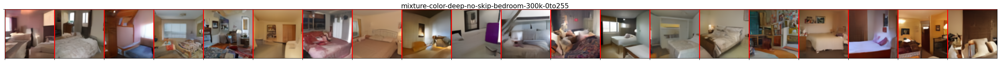

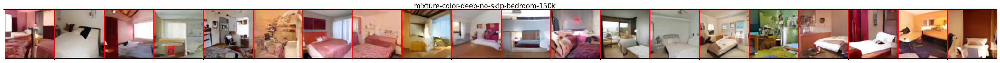

In [75]:
subgroups = ['mixture-color-deep-no-skip-bedroom-300k-0to255', 'mixture-color-deep-no-skip-bedroom-150k']
print( 'fixed_h=', fixed_h, ' sig_L= ',sig_L,  ' sig_0=', sig_0,' h0=', h0, ' beta=',beta, ' seed=', seed)
for group in subgroups:
    show_im_grid(torch.clip(all_samples[group], 0,1), n_columns=20, label=group, grid_lines=True, font_size = 10)

fixed_h= True  sig_L=  0.1  sig_0= 3  h0= 0.01  beta= 0.05  seed= 100


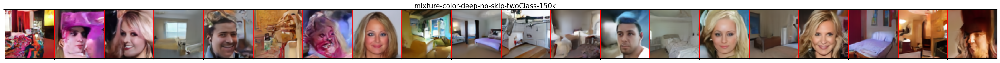

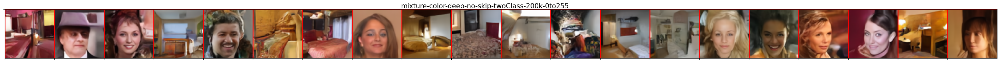

In [53]:

subgroups = ['mixture-color-deep-no-skip-twoClass-150k','mixture-color-deep-no-skip-twoClass-200k-0to255']
print( 'fixed_h=', fixed_h, ' sig_L= ',sig_L,  ' sig_0=', sig_0,' h0=', h0, ' beta=',beta, ' seed=', seed)
for group in subgroups:
    show_im_grid(torch.clip(all_samples[group], 0,1), n_columns=20, label=group, grid_lines=True, font_size = 10)

fixed_h= True  sig_L=  0.1  sig_0= 3  h0= 0.01  beta= 0.05  seed= 100


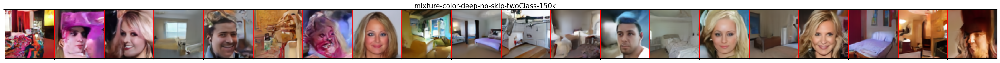

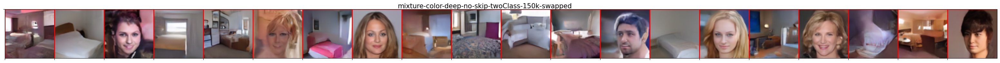

In [54]:

subgroups = ['mixture-color-deep-no-skip-twoClass-150k', 'mixture-color-deep-no-skip-twoClass-150k-swapped']
print( 'fixed_h=', fixed_h, ' sig_L= ',sig_L,  ' sig_0=', sig_0,' h0=', h0, ' beta=',beta, ' seed=', seed)
for group in subgroups:
    show_im_grid(torch.clip(all_samples[group], 0,1), n_columns=20, label=group, grid_lines=True, font_size = 10)

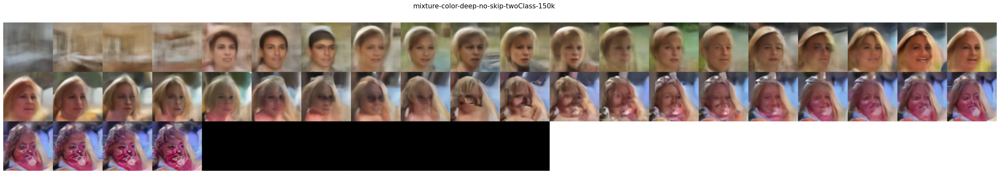

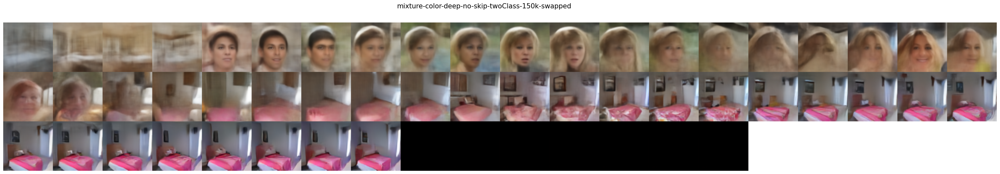

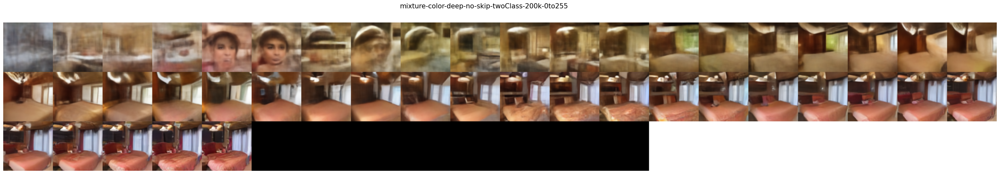

In [38]:
im_n = 6
for group in subgroups:
             
    if 'skip' in group.split('-'): 
        skip = False
    else: 
        skip = True
    show_im_grid(torch.clip(traj_projections(torch.stack(all_interm_Ys[group])[:,im_n], denoisers[group], skip=skip ) , 0 ,1), n_columns=20, label = group, font_size = 10)


### Expectation: 

Improvemnet in quality with more data 

fixed_h= True  sig_L=  0.1  sig_0= 3  h0= 0.01  beta= 0.05  seed= 100


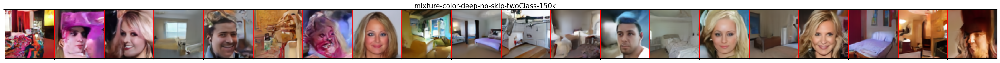

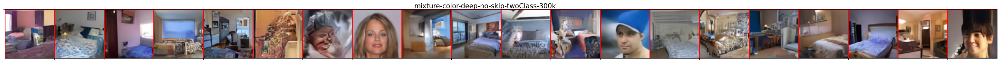

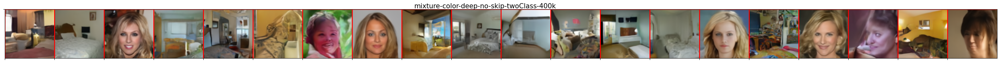

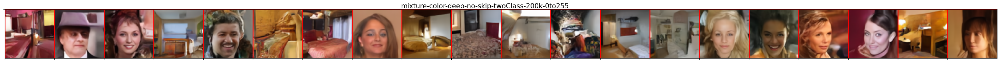

In [39]:
subgroups = [ 'mixture-color-deep-no-skip-twoClass-150k', 'mixture-color-deep-no-skip-twoClass-300k', 'mixture-color-deep-no-skip-twoClass-400k',  'mixture-color-deep-no-skip-twoClass-200k-0to255' ]
print( 'fixed_h=', fixed_h, ' sig_L= ',sig_L,  ' sig_0=', sig_0,' h0=', h0, ' beta=',beta, ' seed=', seed)
for group in subgroups:
    show_im_grid(torch.clip(all_samples[group], 0,1), n_columns=20, label=group, grid_lines=True, font_size = 10)

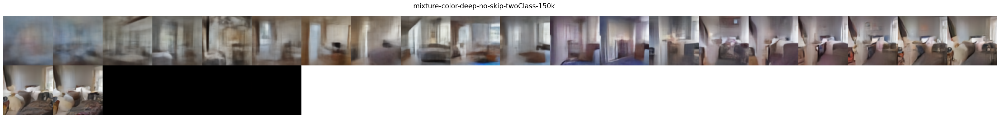

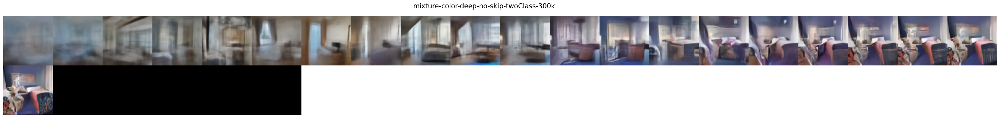

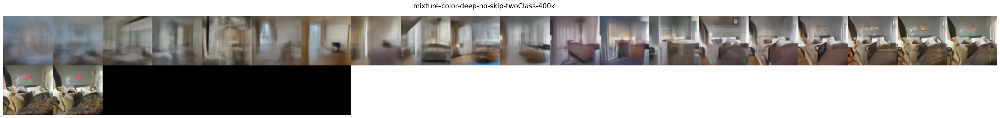

In [30]:
im_n = 11
for group in subgroups:
             
    if 'skip' in group.split('-'): 
        skip = False
    else: 
        skip = True
    show_im_grid(torch.clip(traj_projections(torch.stack(all_interm_Ys[group])[:,im_n][0::2], denoisers[group], skip=skip ) , 0 ,1), n_columns=20, label = group, font_size = 10)


### Expectation: 
reduction of quality compared to ultimate conditional models, even though the joint model is trained on all data

fixed_h= True  sig_L=  0.1  sig_0= 3  h0= 0.01  beta= 0.05  seed= 100


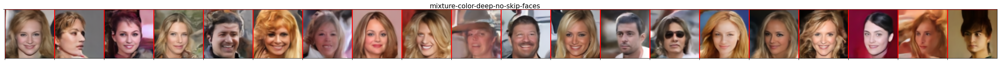

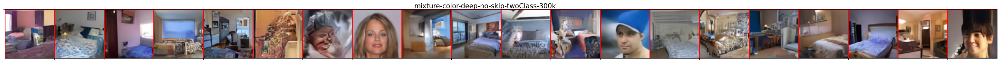

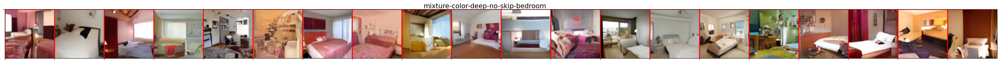

In [540]:
subgroups = ['mixture-color-deep-no-skip-faces-150k',  'mixture-color-deep-no-skip-twoClass-300k', 'mixture-color-deep-no-skip-bedroom-150k' ]
print( 'fixed_h=', fixed_h, ' sig_L= ',sig_L,  ' sig_0=', sig_0,' h0=', h0, ' beta=',beta, ' seed=', seed)
for group in subgroups:
    show_im_grid(torch.clip(all_samples[group], 0,1), n_columns=20, label=group, grid_lines=True, font_size = 10)

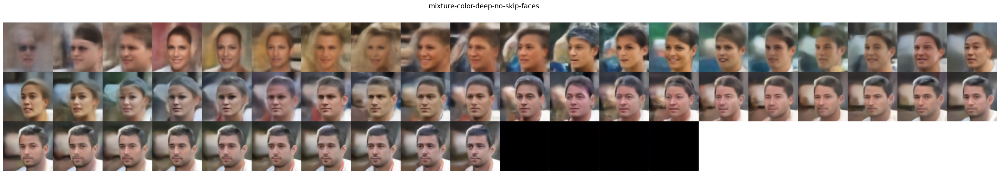

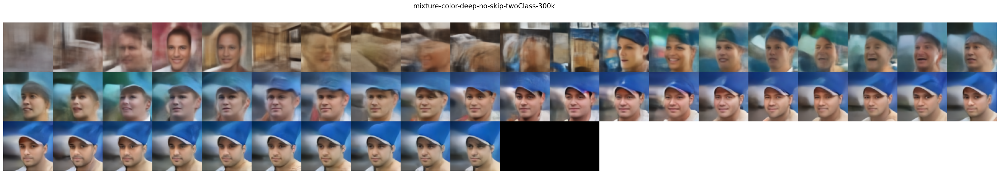

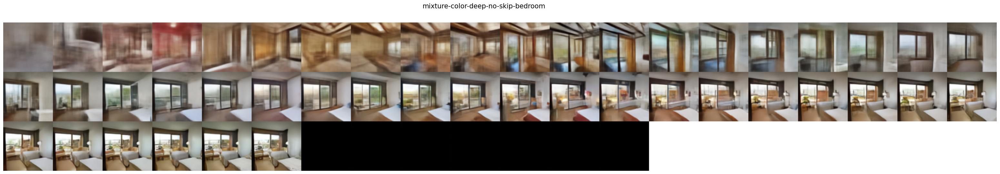

In [553]:
im_n = 12
for group in subgroups:
             
    if 'skip' in group.split('-'): 
        skip = False
    else: 
        skip = True
    show_im_grid(torch.clip(traj_projections(torch.stack(all_interm_Ys[group])[:,im_n], denoisers[group], skip=skip ) , 0 ,1), n_columns=20, label = group, font_size = 10)
